In [1]:
import os
from tqdm import tqdm
from glob import glob

import numpy as np
import pandas as pd

from sklearn.calibration import CalibratedClassifierCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import plot_tree
from sklearn.model_selection import GridSearchCV, train_test_split

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

import cv2
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

In [2]:
def clf(x):
    pred_class = "Cents"
    if x['ring_1_s_kurtosis'] <= 0.887:
        if x['ring_3_h_std'] <= 50.993:
            if x['ring_3_s_kurtosis'] <= -0.461:
                pred_class = "Nickels"
            else:
                pred_class = "Quarters"
        else:
            if x['ring_2_s_std'] <= 52.097:
                pred_class = "Quarters"
            else:
                pred_class = "Cents"
    else:
        if x['ring_2_v_kurtosis'] <= -1.311:
            pred_class = "Nickels"
            if x['ring_4_magnitude_median'] <= 0.707:
                pred_class = "Quarters"
            else:
                pred_class = "Cents"
    
    return pred_class

In [3]:
from extract_features import extract_image_features, extract_features_single_image, crop_coins_from_background

def clf_coins(img_path, color_threshold_method = None):
    cropped_objects = crop_coins_from_background(img_path, 
                                                 color_threshold_method = color_threshold_method, 
                                                 kernel_size = 3)
    temp = cv2.imread(img_path)
    temp = cv2.cvtColor(temp, cv2.COLOR_BGR2RGB)
    plt.imshow(temp)
    plt.axis('off');

    del temp
    
    fig, axs = plt.subplots(1, len(cropped_objects), figsize = (23, 15))
    for i, (cropped_obj, ax) in enumerate(zip(cropped_objects, axs)):
        pred_label = extract_features_single_image(cropped_obj).apply(clf, axis = 1)
        ax.imshow(cv2.cvtColor(cropped_obj, cv2.COLOR_BGR2RGB))
        ax.set_title(f'Object {i + 1}\nClass: {pred_label}')
        ax.axis('off')

    fig.tight_layout()
    plt.show()

# Default

Cropped 1/8
Cropped 2/8
Cropped 3/8
Cropped 4/8
Cropped 5/8
Cropped 6/8
Cropped 7/8
Cropped 8/8


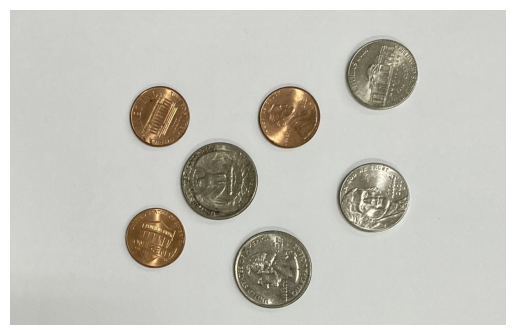

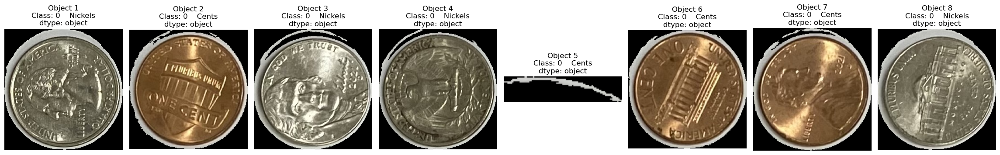

Cropped 1/15
Cropped 2/15
Cropped 3/15
Cropped 4/15
Cropped 5/15
Cropped 6/15
Cropped 7/15
Cropped 8/15
Cropped 9/15
Cropped 10/15
Cropped 11/15
Cropped 12/15
Cropped 13/15
Cropped 14/15
Cropped 15/15


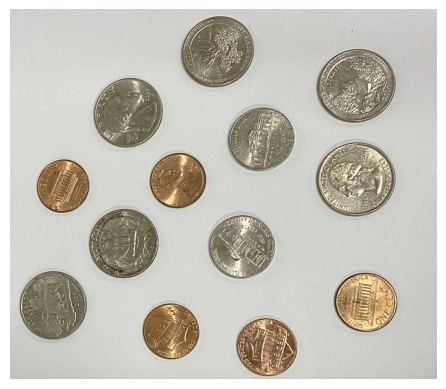

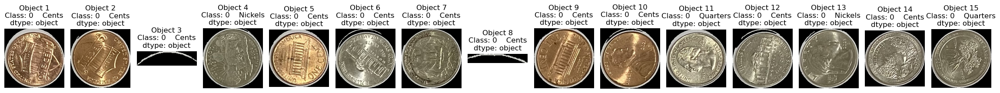

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


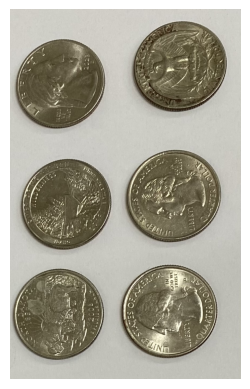

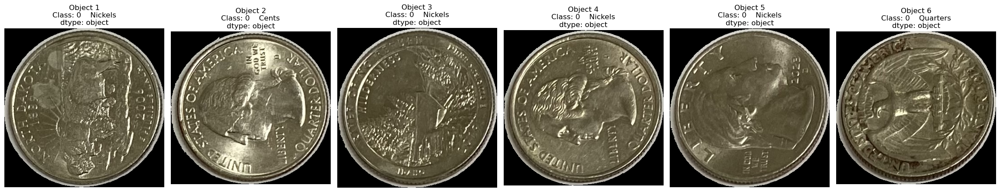

Cropped 1/8
Cropped 2/8
Cropped 3/8
Cropped 4/8
Cropped 5/8
Cropped 6/8
Cropped 7/8
Cropped 8/8


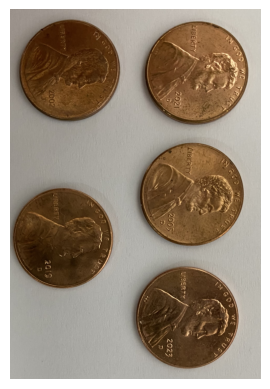

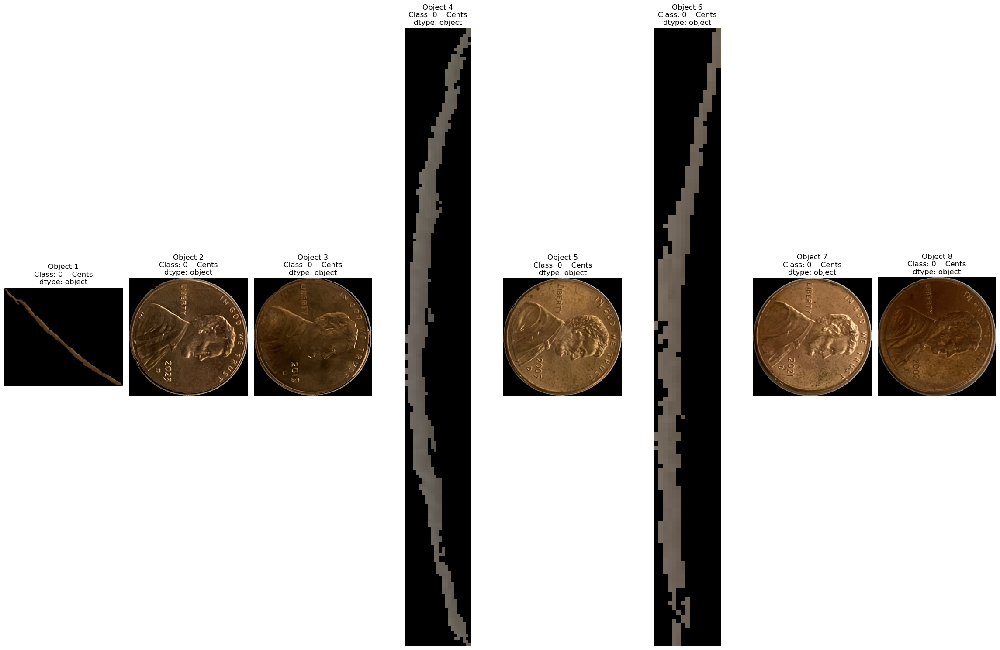

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


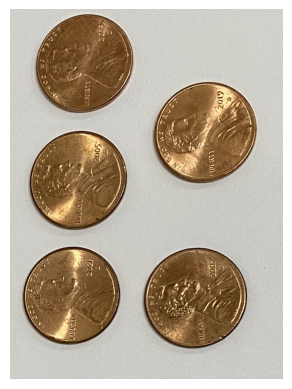

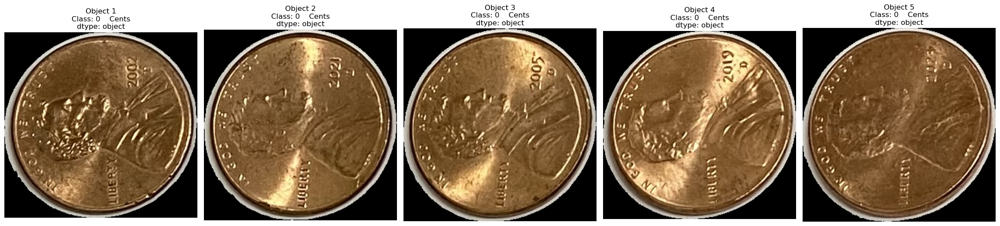

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


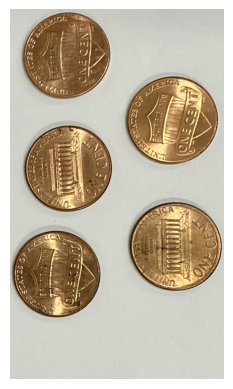

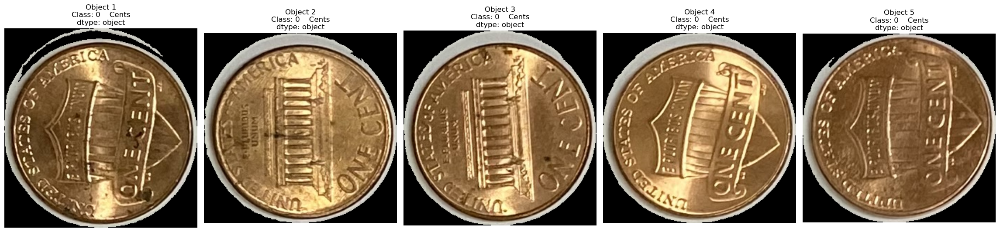

Cropped 1/2
Cropped 2/2


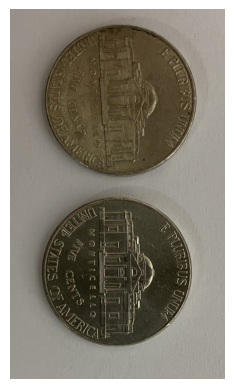

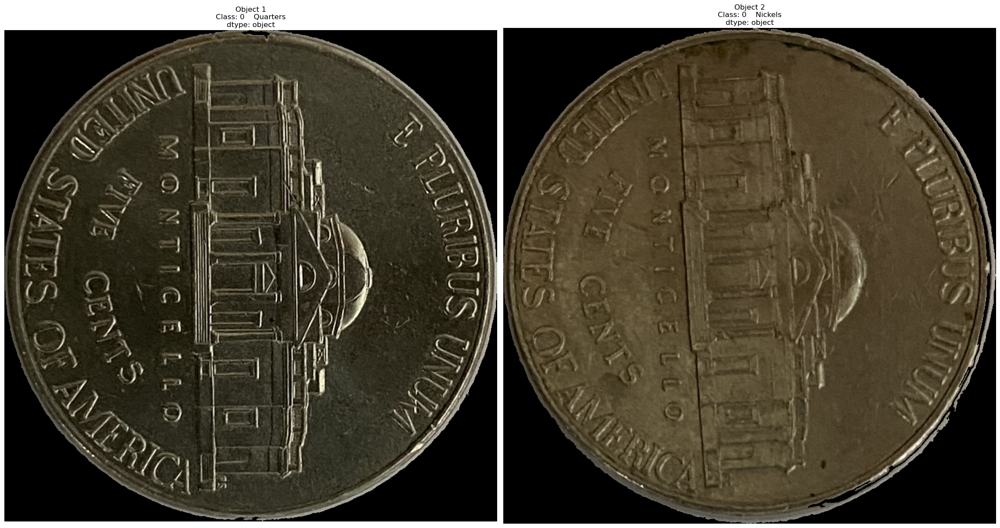

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


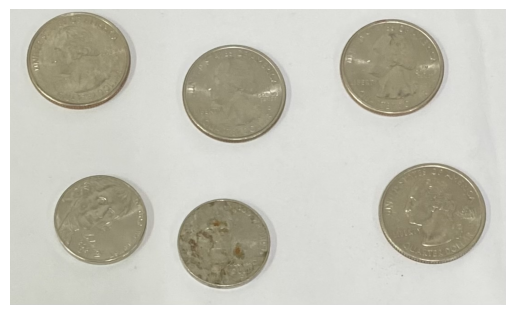

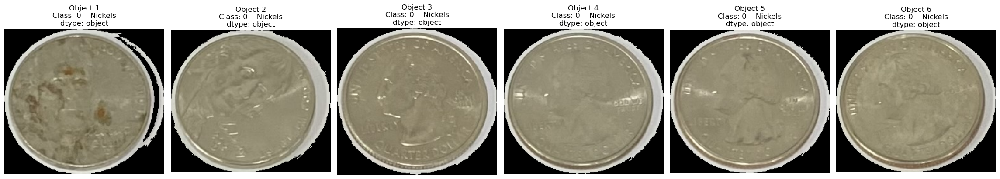


Failed 8 images



In [4]:
fail_cnt = 0
failed_ind = []
for ind, img_file in enumerate(glob('./real_life_pic/*')):
    try:
        clf_coins(img_file)
    except:
        failed_ind.append(ind)
        fail_cnt += 1

print(f"\nFailed {fail_cnt} images\n")

# LAB Threshold

Cropped 1/9
Cropped 2/9
Cropped 3/9
Cropped 4/9
Cropped 5/9
Cropped 6/9
Cropped 7/9
Cropped 8/9
Cropped 9/9


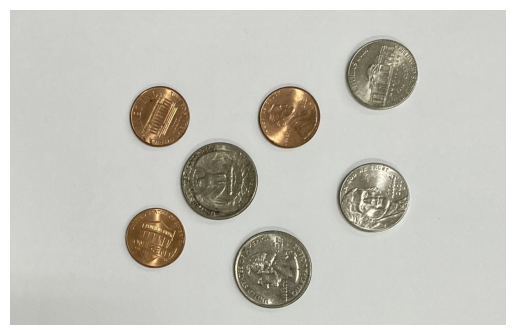

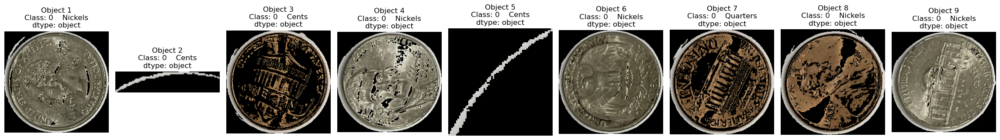

Cropped 1/14
Cropped 2/14
Cropped 3/14
Cropped 4/14
Cropped 5/14
Cropped 6/14
Cropped 7/14
Cropped 8/14
Cropped 9/14
Cropped 10/14
Cropped 11/14
Cropped 12/14
Cropped 13/14
Cropped 14/14


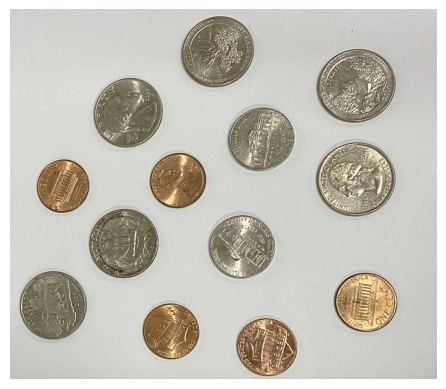

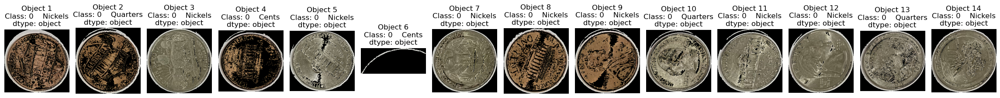

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


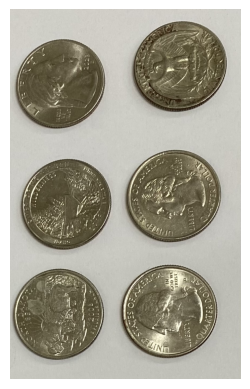

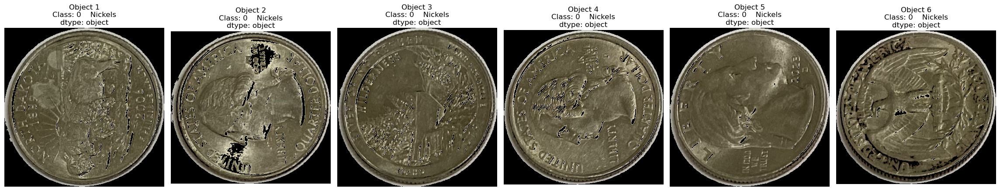

Cropped 1/14
Cropped 2/14
Cropped 3/14
Cropped 4/14
Cropped 5/14
Cropped 6/14
Cropped 7/14
Cropped 8/14
Cropped 9/14
Cropped 10/14
Cropped 11/14
Cropped 12/14
Cropped 13/14
Cropped 14/14


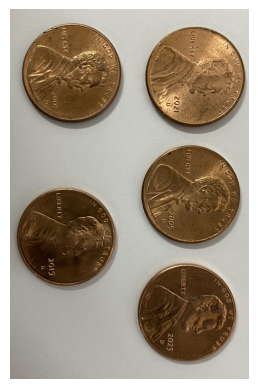

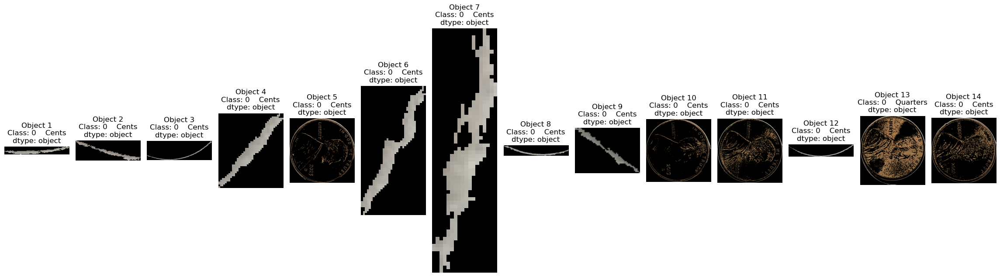

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


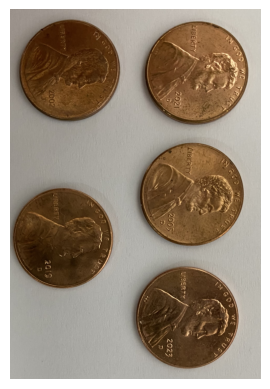

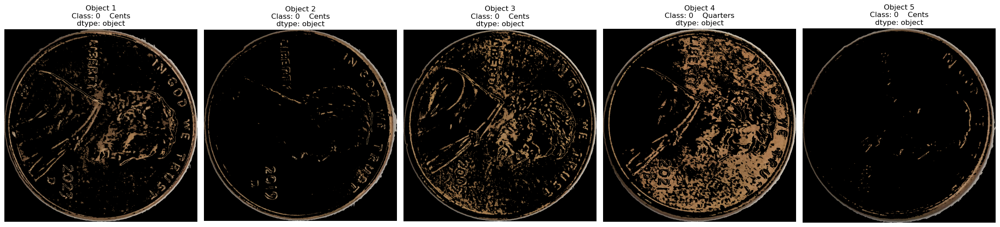

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


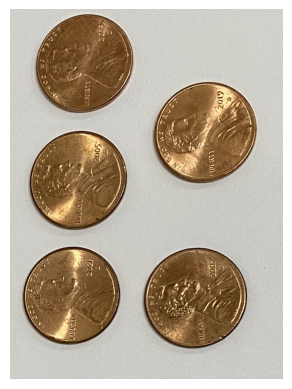

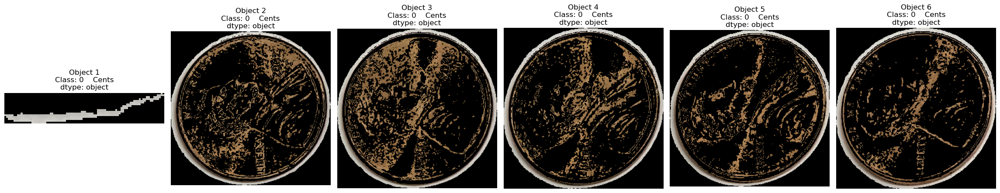

Cropped 1/7
Cropped 2/7
Cropped 3/7
Cropped 4/7
Cropped 5/7
Cropped 6/7
Cropped 7/7


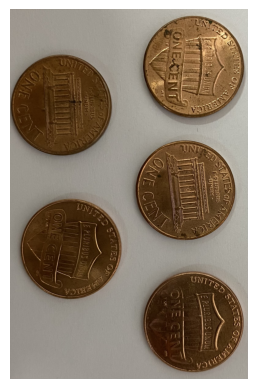

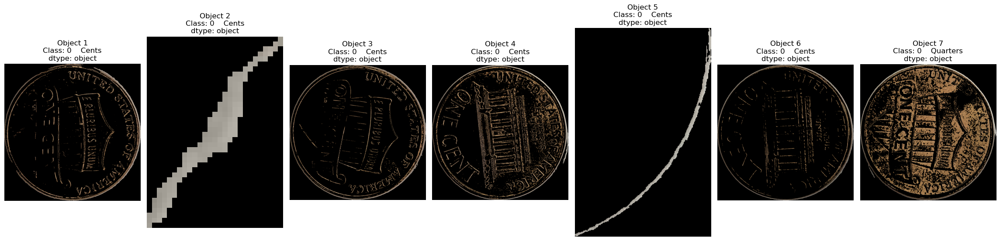

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


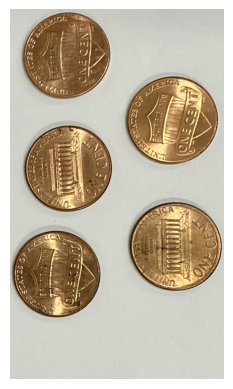

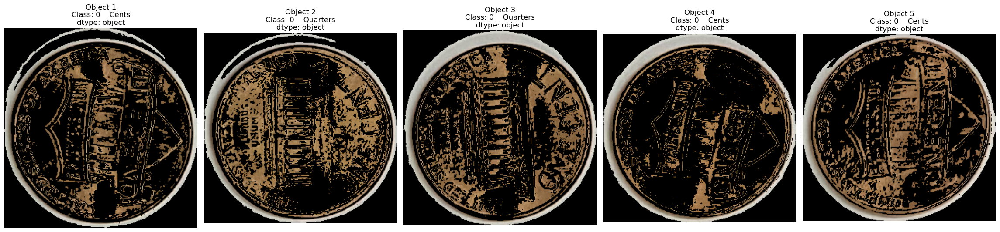

Cropped 1/2
Cropped 2/2


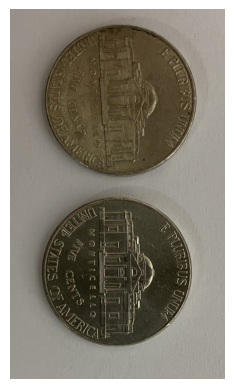

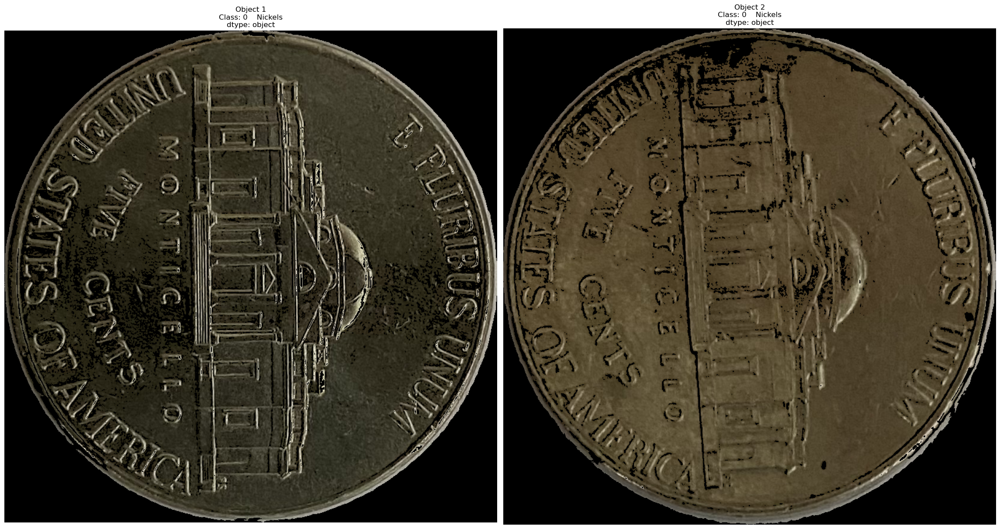

Cropped 1/4
Cropped 2/4
Cropped 3/4
Cropped 4/4


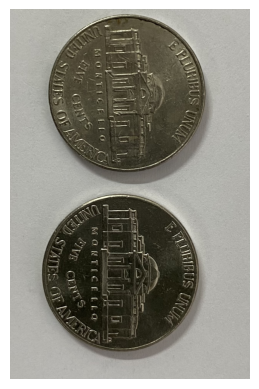

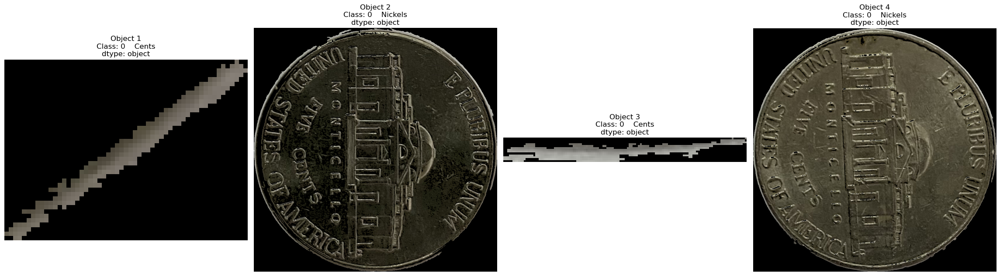

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


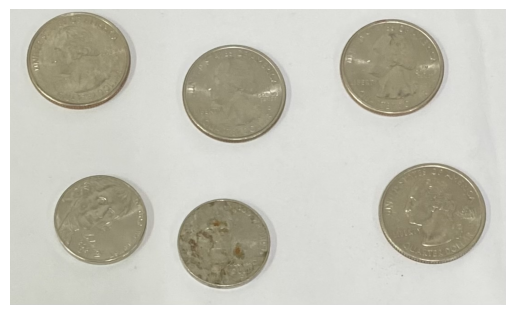

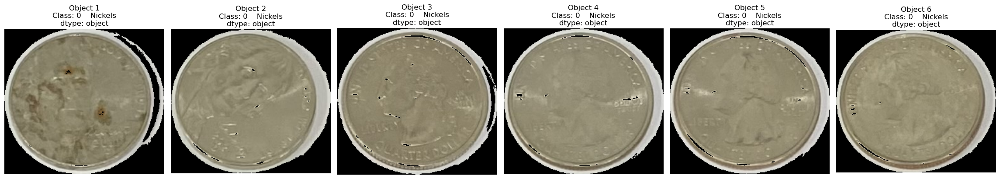


Failed 5 images



In [5]:
failed_ind = []
fail_cnt = 0
for ind, img_file in enumerate(glob('./real_life_pic/*')):
    try:
        clf_coins(img_file, color_threshold_method = 'hsl')
    except:
        failed_ind.append(ind)
        fail_cnt += 1

print(f"\nFailed {fail_cnt} images\n")

# HSL Threshold

Cropped 1/8
Cropped 2/8
Cropped 3/8
Cropped 4/8
Cropped 5/8
Cropped 6/8
Cropped 7/8
Cropped 8/8


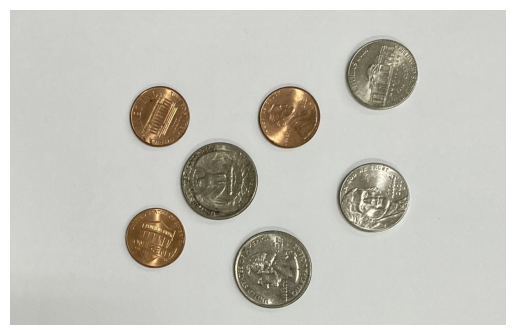

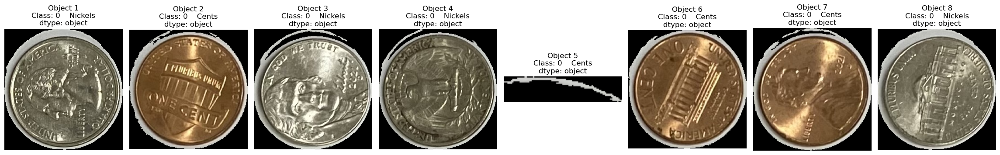

Cropped 1/15
Cropped 2/15
Cropped 3/15
Cropped 4/15
Cropped 5/15
Cropped 6/15
Cropped 7/15
Cropped 8/15
Cropped 9/15
Cropped 10/15
Cropped 11/15
Cropped 12/15
Cropped 13/15
Cropped 14/15
Cropped 15/15


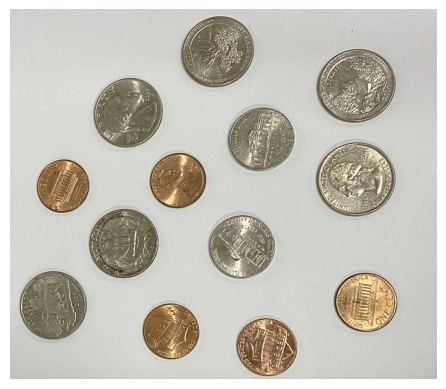

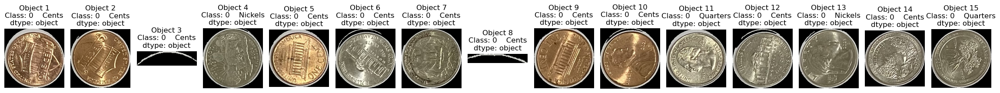

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


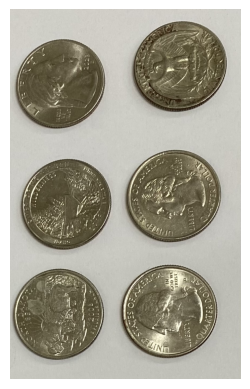

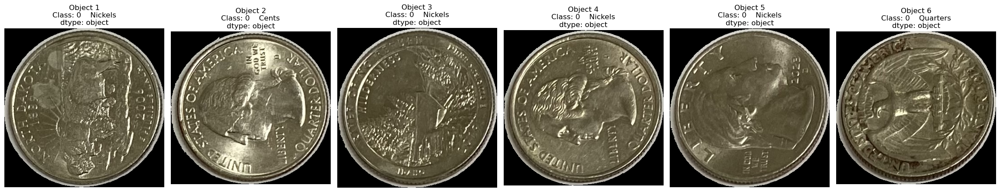

Cropped 1/8
Cropped 2/8
Cropped 3/8
Cropped 4/8
Cropped 5/8
Cropped 6/8
Cropped 7/8
Cropped 8/8


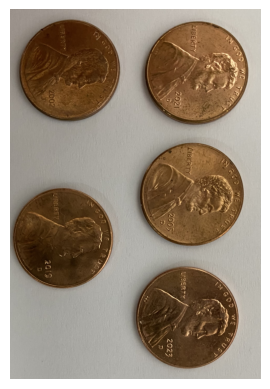

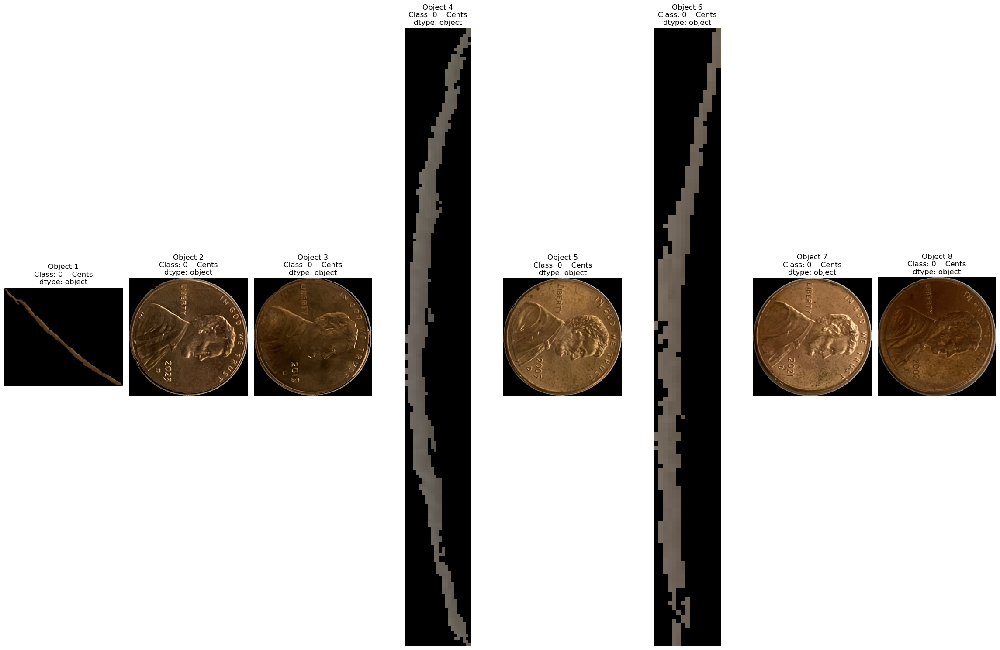

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


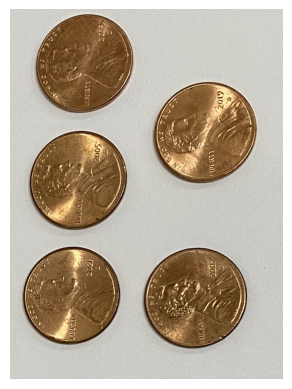

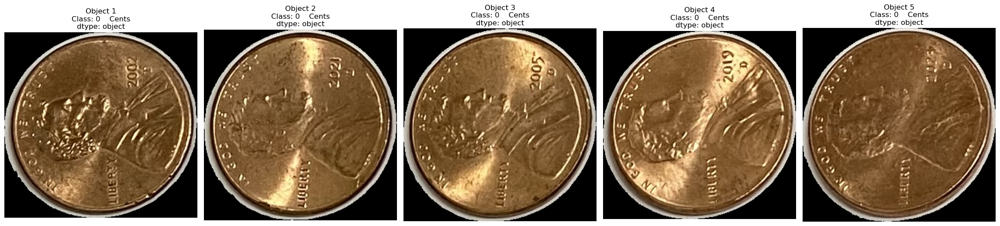

Cropped 1/5
Cropped 2/5
Cropped 3/5
Cropped 4/5
Cropped 5/5


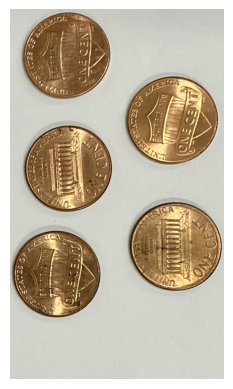

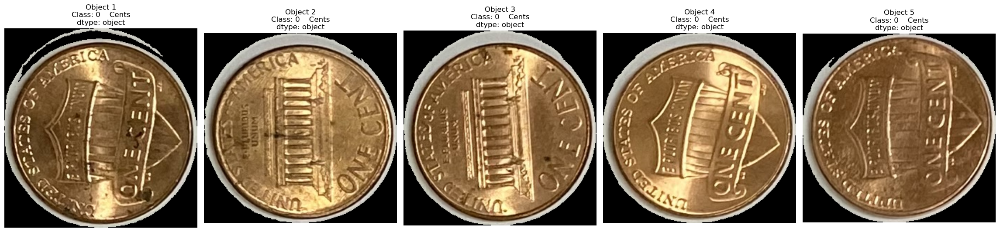

Cropped 1/2
Cropped 2/2


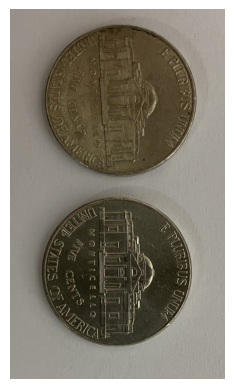

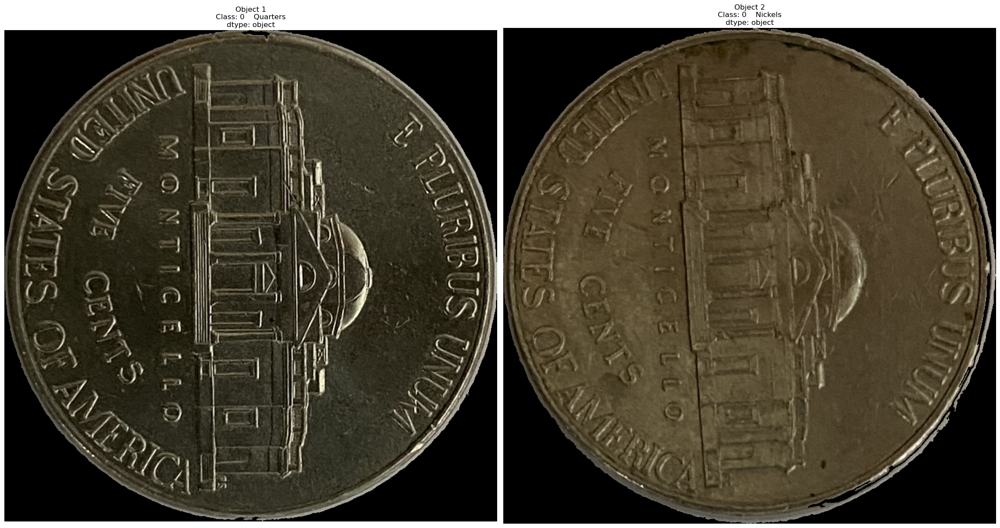

Cropped 1/6
Cropped 2/6
Cropped 3/6
Cropped 4/6
Cropped 5/6
Cropped 6/6


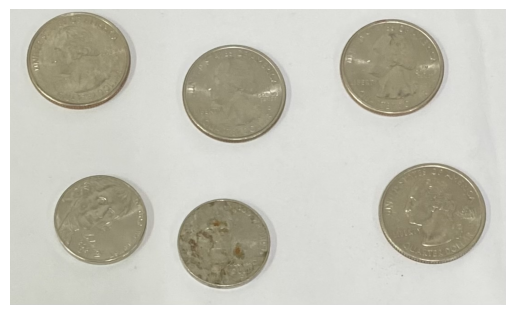

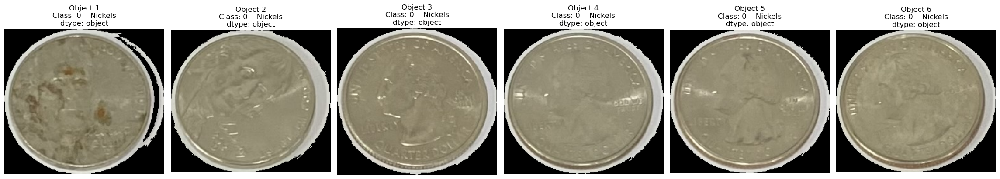


Failed 8 images



In [6]:
failed_ind = []
fail_cnt = 0

for ind, img_file in enumerate(glob('./real_life_pic/*')):
    try:
        clf_coins(img_file, color_threshold_method = 'lab')
    except:
        failed_ind.append(ind)
        fail_cnt += 1

print(f"\nFailed {fail_cnt} images\n")